# CSc I6716 Final Project: Window Screen Removal via Visual Motion Analysis

This notebook provides an interactive demonstration of the screen removal pipeline,
allowing step-by-step exploration of each phase.

## Project Goal

Remove the periodic visual artifact (window screen) from a video sequence using:
1. Image Restoration/Enhancement
2. Visual Motion/Video Computing
3. Linear Algebra and Filtering


In [28]:
# Import required libraries
import numpy as np
import cv2
from scipy import ndimage
from scipy.signal import convolve2d
import matplotlib.pyplot as plt
from pathlib import Path

# Import our modules
from screen_removal import ScreenRemovalPipeline, load_video_frames, preprocess_frames
from screen_removal import compute_optical_flow_pyramidal, visualize_optical_flow
from screen_removal import motion_compensate_frames, temporal_average_filter
from screen_removal import bilateral_filter, simple_lowpass_filter, rgb_to_grayscale_ntsc
from screen_removal import estimate_global_motion
from classical_cv_utils import sobel_operator, harris_corner_detector
from classical_cv_utils import analyze_frequency_spectrum, detect_periodic_pattern

# Configure matplotlib for HIGH QUALITY output
%matplotlib inline
plt.rcParams['figure.figsize'] = [14, 10]
plt.rcParams['figure.dpi'] = 150  # Display DPI (300 for saved files)
plt.rcParams['savefig.dpi'] = 300  # Save with high DPI
plt.rcParams['savefig.bbox'] = 'tight'
plt.rcParams['savefig.facecolor'] = 'white'
plt.rcParams['image.cmap'] = 'gray'
plt.rcParams['font.size'] = 12

print("All modules loaded successfully!")
print(f"Figure display DPI: {plt.rcParams['figure.dpi']}")
print(f"Figure save DPI: {plt.rcParams['savefig.dpi']}")


All modules loaded successfully!
Figure display DPI: 150.0
Figure save DPI: 300.0


## Configuration

Set the path to your video file and processing parameters.


In [29]:
# ===== CONFIGURATION =====
VIDEO_PATH = "20220822_deer.mp4"  

NUM_FRAMES = 7        
START_FRAME = 10000   
MOTION_METHOD = 'homography' # 'homography' or 'flow' - flow is more accurate
USE_MEDIAN = False      # Use median instead of mean (reduces blur)
APPLY_SHARPENING = True  
OUTPUT_DIR = f"results_{NUM_FRAMES}_{START_FRAME}_{MOTION_METHOD}_{USE_MEDIAN}_{APPLY_SHARPENING}"



print(f"Video: {VIDEO_PATH}")
print(f"Frames: {NUM_FRAMES}")
print(f"Motion method: {MOTION_METHOD}")
print(f"Use median: {USE_MEDIAN}")
print(f"Apply sharpening: {APPLY_SHARPENING}")
print(f"Output directory: {OUTPUT_DIR}/ (DPI: 300)")


Video: 20220822_deer.mp4
Frames: 7
Motion method: homography
Use median: False
Apply sharpening: True
Output directory: results_7_10000_homography_False_True/ (DPI: 300)


In [30]:
# ============================================================================
# Define all configurations to test and compare
# ============================================================================

VIDEO_PATH = "20220822_deer.mp4"

# Define configurations to test
configs = [
    # # BAD configurations (for comparison)
    # dict(name="BAD-3F-Mean-NoSharp",     NUM_FRAMES=3,  START_FRAME=100, MOTION_METHOD='flow',      USE_MEDIAN=False, APPLY_SHARPENING=False),
    # dict(name="BAD-28F-Mean-NoSharp",    NUM_FRAMES=28, START_FRAME=100, MOTION_METHOD='flow',      USE_MEDIAN=False, APPLY_SHARPENING=False),
    
    # # GOOD configurations (Flow)
    # dict(name="GOOD-5F-Flow-Med-Sharp",    NUM_FRAMES=5,  START_FRAME=100, MOTION_METHOD='flow',      USE_MEDIAN=True,  APPLY_SHARPENING=True),
    # dict(name="OPTIMAL-7F-Flow-Med-Sharp", NUM_FRAMES=7,  START_FRAME=100, MOTION_METHOD='flow',      USE_MEDIAN=True,  APPLY_SHARPENING=True),
    # dict(name="GOOD-9F-Flow-Med-Sharp",    NUM_FRAMES=9,  START_FRAME=100, MOTION_METHOD='flow',      USE_MEDIAN=True,  APPLY_SHARPENING=True),
    
    # # Homography comparison
    # dict(name="ALT-7F-Homo-Med-Sharp",   NUM_FRAMES=7,  START_FRAME=100, MOTION_METHOD='homography', USE_MEDIAN=True,  APPLY_SHARPENING=True),
    # dict(name="ALT-28F-Homo-Med-Sharp",  NUM_FRAMES=28, START_FRAME=100, MOTION_METHOD='homography', USE_MEDIAN=True,  APPLY_SHARPENING=True),
]

import time
results_summary = []

for i, conf in enumerate(configs, 1):
    print(f"\n[{i}/{len(configs)}] Running: {conf['name']}")
    print("-" * 80)
    
    # defensive fix: ensure both old and typo'd keys are present
    apply_sharpening = (
        conf['APPLY_SHARPENING'] 
        if 'APPLY_SHARPENING' in conf 
        else conf.get('APPLY_SHARPNING', False)
    )
    output_dir = f"results_{conf['NUM_FRAMES']}_{conf['START_FRAME']}_{conf['MOTION_METHOD']}_{conf['USE_MEDIAN']}_{apply_sharpening}"
    
    start_time = time.time()
    
    # Create and run pipeline
    pipeline = ScreenRemovalPipeline(
        num_frames=conf['NUM_FRAMES'],
        motion_method=conf['MOTION_METHOD'],
        post_processing='none',
        use_median=conf['USE_MEDIAN'],
        apply_sharpening=apply_sharpening,
        sharpening_strength=0.8
    )
    
    restored, metrics = pipeline.run(
        video_path=VIDEO_PATH,
        output_dir=output_dir,
        start_frame=conf['START_FRAME'],
        use_color=True
    )
    
    elapsed_time = time.time() - start_time
    
    # Store results
    results_summary.append({
        'name': conf['name'],
        'frames': conf['NUM_FRAMES'],
        'method': conf['MOTION_METHOD'],
        'filter': 'Median' if conf['USE_MEDIAN'] else 'Mean',
        'sharpening': 'ON' if apply_sharpening else 'OFF',
        'hfe_original': metrics['hf_original'],
        'hfe_restored': metrics['hf_restored'],
        'time': elapsed_time,
        'output_dir': output_dir
    })
    
    print(f"✓ Completed in {elapsed_time:.1f} seconds")
    print(f"  HFE: {metrics['hf_restored']:.6f}")

print("\n" + "=" * 80)
print("BATCH PROCESSING COMPLETE")
print("=" * 80)



BATCH PROCESSING COMPLETE


## 1.2 Grayscale Conversion (NTSC Formula)

Converting to grayscale using the NTSC luminance formula:
$$ I = 0.299R + 0.587G + 0.114B $$

This weights color channels according to human perception.


Preprocessed 7 frames to grayscale


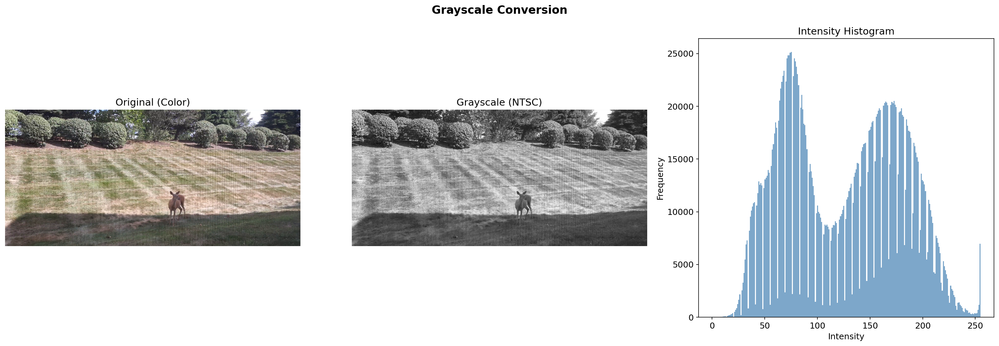

In [31]:
#creating OUTPUT_DIR if it doesn't exist 
Path(OUTPUT_DIR).mkdir(exist_ok=True)

# Ensure frames_bgr is loaded before this block
if 'frames_bgr' not in locals():
    print(f"Loading video frames from {VIDEO_PATH} ...")
    frames_bgr = load_video_frames(VIDEO_PATH, num_frames=NUM_FRAMES, start_frame=START_FRAME)

# Flowchart Block: "Convert to Grayscale (NTSC)"
# Preprocess frames
gray_frames, color_frames = preprocess_frames(frames_bgr)

# Display grayscale conversion
fig, axes = plt.subplots(1, 3, figsize=(20, 7))

# Original color
axes[0].imshow(cv2.cvtColor(frames_bgr[0], cv2.COLOR_BGR2RGB))
axes[0].set_title('Original (Color)', fontsize=14)
axes[0].axis('off')

# Grayscale (NTSC)
axes[1].imshow(gray_frames[0], cmap='gray')
axes[1].set_title('Grayscale (NTSC)', fontsize=14)
axes[1].axis('off')

# Histogram
axes[2].hist(gray_frames[0].flatten(), bins=256, color='steelblue', alpha=0.7)
axes[2].set_title('Intensity Histogram', fontsize=14)
axes[2].set_xlabel('Intensity')
axes[2].set_ylabel('Frequency')

plt.suptitle('Grayscale Conversion', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.savefig(f'{OUTPUT_DIR}/grayscale_conversion.png')
plt.show()


## 1.3 Artifact Identification (Frequency Analysis)

**📊 Flowchart Reference:** See `PIPELINE_APPROACHES.md` - "Identify Screen (Diagnostic Only)"
- This is a PARALLEL diagnostic step - does NOT feed into Phase 2
- Used for understanding/visualization only
- Phase 2 uses `gray_frames` directly, not frequency analysis results

The screen grid appears as high-frequency periodic noise. Let's analyze it in the frequency domain.


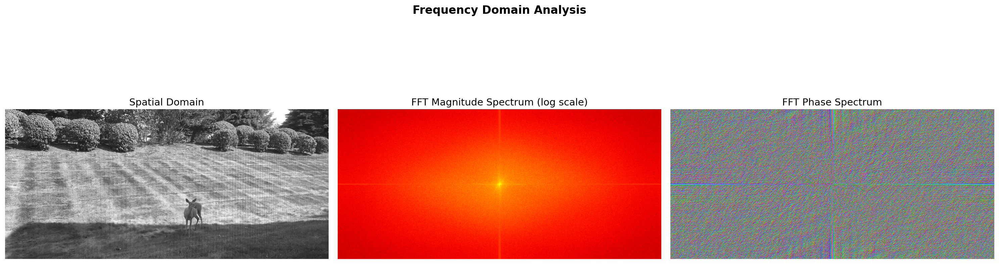


Detected periodic pattern:
  Horizontal period: 29.2 pixels
  Vertical period: 30.0 pixels


In [32]:
# Flowchart Block: "Identify Screen (Diagnostic Only)"
# This is NOT used as input to Phase 2 - it's for understanding only
# Phase 2 uses gray_frames directly
# Frequency spectrum analysis
magnitude, phase = analyze_frequency_spectrum(gray_frames[0])

fig, axes = plt.subplots(1, 3, figsize=(20, 7))

# Spatial domain
axes[0].imshow(gray_frames[0], cmap='gray')
axes[0].set_title('Spatial Domain', fontsize=14)
axes[0].axis('off')

# Magnitude spectrum
axes[1].imshow(magnitude, cmap='hot')
axes[1].set_title('FFT Magnitude Spectrum (log scale)', fontsize=14)
axes[1].axis('off')

# Phase spectrum
axes[2].imshow(phase, cmap='hsv')
axes[2].set_title('FFT Phase Spectrum', fontsize=14)
axes[2].axis('off')

plt.suptitle('Frequency Domain Analysis', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.savefig(f'{OUTPUT_DIR}/frequency_analysis.png')
plt.show()

# Detect periodic pattern
pattern = detect_periodic_pattern(gray_frames[0])
if pattern:
    print(f"\nDetected periodic pattern:")
    print(f"  Horizontal period: {pattern[0]:.1f} pixels" if pattern[0] else "  No horizontal pattern")
    print(f"  Vertical period: {pattern[1]:.1f} pixels" if pattern[1] else "  No vertical pattern")


---
# Phase 2: Visual Motion Estimation

**📊 Flowchart Reference:** - Phase 2 Block
- Input: `gray_frames` from Phase 1 (NOT frequency analysis results)
- Decision Point 1: Choose motion method (Homography vs Optical Flow)
- Output: transforms (homography matrices or flow vectors)

## 2.1 Feature Detection (Harris Corners and Sobel Gradients)


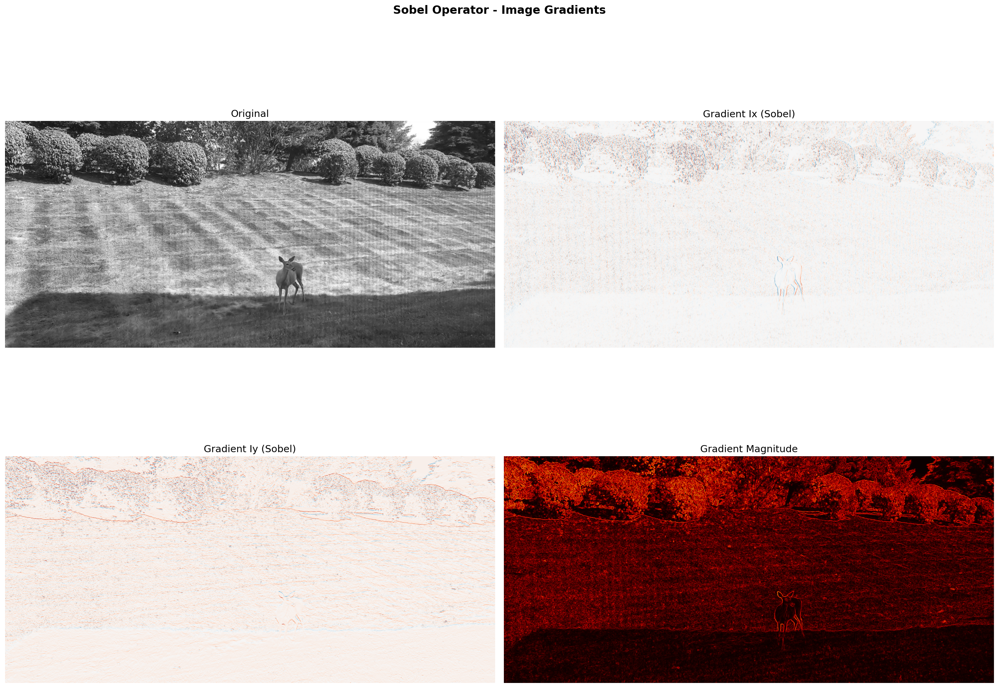

In [33]:
# Flowchart Block: "Feature Detection (Sobel)" - Part of Phase 2
# Compute gradients using Sobel operator
Ix, Iy, magnitude = sobel_operator(gray_frames[0])

fig, axes = plt.subplots(2, 2, figsize=(20, 16))

axes[0][0].imshow(gray_frames[0], cmap='gray')
axes[0][0].set_title('Original', fontsize=14)

axes[0][1].imshow(Ix, cmap='RdBu')
axes[0][1].set_title('Gradient Ix (Sobel)', fontsize=14)

axes[1][0].imshow(Iy, cmap='RdBu')
axes[1][0].set_title('Gradient Iy (Sobel)', fontsize=14)

axes[1][1].imshow(magnitude, cmap='hot')
axes[1][1].set_title('Gradient Magnitude', fontsize=14)

for axs in axes:
    for ax in axs:
        ax.axis('off')

plt.suptitle('Sobel Operator - Image Gradients', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.savefig(f'{OUTPUT_DIR}/sobel_gradients.png')
plt.show()


Detected 373850 corners


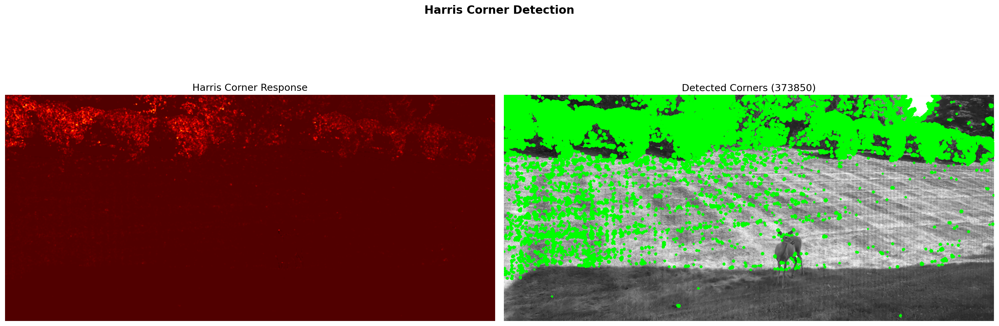

In [34]:
# Flowchart Block: "Feature Detection (Harris)" - Part of Phase 2
# Harris corner detection
corners, harris_response = harris_corner_detector(gray_frames[0], k=0.04, sigma=2.0, threshold_ratio=0.01)

print(f"Detected {len(corners)} corners")

fig, axes = plt.subplots(1, 2, figsize=(20, 8))

# Harris response
axes[0].imshow(harris_response, cmap='hot')
axes[0].set_title('Harris Corner Response', fontsize=14)
axes[0].axis('off')

# Corners overlaid on image
axes[1].imshow(gray_frames[0], cmap='gray')
if len(corners) > 0:
    axes[1].scatter(corners[:, 1], corners[:, 0], c='lime', s=10, marker='+')
axes[1].set_title(f'Detected Corners ({len(corners)})', fontsize=14)
axes[1].axis('off')

plt.suptitle('Harris Corner Detection', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.savefig(f'{OUTPUT_DIR}/harris_corners.png')
plt.show()


## 2.2 Motion Field Calculation (Optical Flow)

Computing dense optical flow between consecutive frames using Farneback method.

The optical flow constraint equation:
$$ I_x u + I_y v + I_t = 0 $$

Where:
- $(u, v)$ is the velocity field (optical flow)
- $I_x, I_y$ are spatial gradients
- $I_t$ is the temporal gradient


Flow statistics:
  Mean horizontal flow (u): -0.4066 pixels
  Mean vertical flow (v): 0.4937 pixels
  Max flow magnitude: 2.4795 pixels
  99th percentile magnitude: 1.3487 pixels


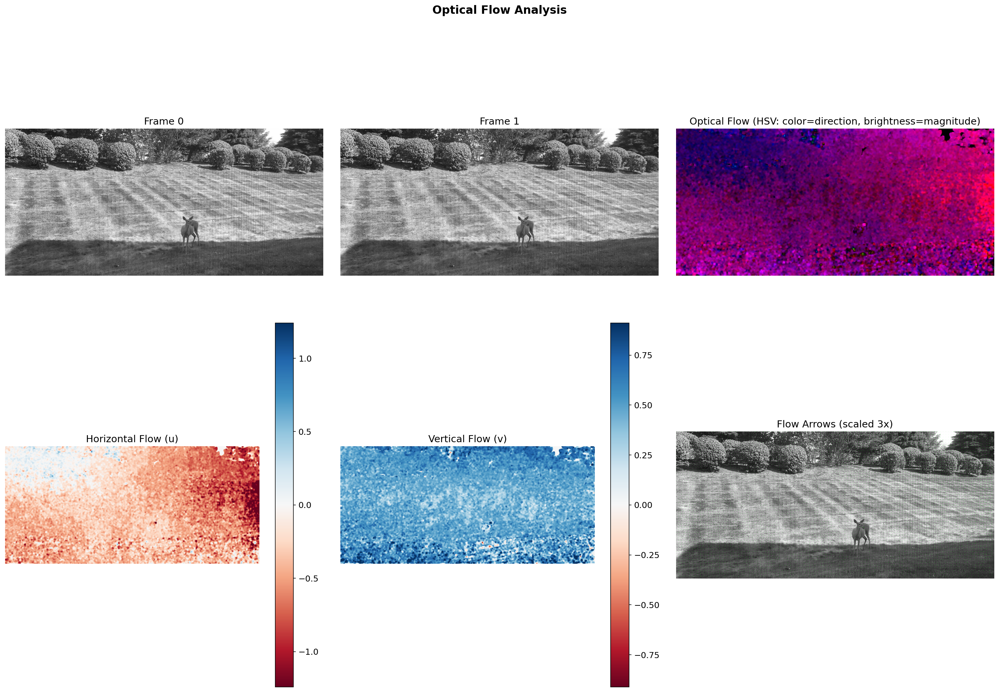

In [35]:
# Flowchart Block: "Approach 2B: Optical Flow" (if MOTION_METHOD='flow')
# Reload module to get updated functions
import importlib
import screen_removal
importlib.reload(screen_removal)
from screen_removal import visualize_optical_flow, visualize_optical_flow_arrows

# Compute optical flow between frame 0 and frame 1
u, v = compute_optical_flow_pyramidal(gray_frames[0], gray_frames[1])

# Compute flow statistics first
flow_mag = np.sqrt(u**2 + v**2)
print(f"Flow statistics:")
print(f"  Mean horizontal flow (u): {u.mean():.4f} pixels")
print(f"  Mean vertical flow (v): {v.mean():.4f} pixels")
print(f"  Max flow magnitude: {flow_mag.max():.4f} pixels")
print(f"  99th percentile magnitude: {np.percentile(flow_mag, 99):.4f} pixels")

# Visualize flow - HSV color coded
flow_viz = visualize_optical_flow(u, v)

# Also create arrow visualization
flow_arrows = visualize_optical_flow_arrows(gray_frames[0], u, v, step=20, scale=3.0)

fig, axes = plt.subplots(2, 3, figsize=(20, 14))

# Frame 1
axes[0, 0].imshow(gray_frames[0], cmap='gray')
axes[0, 0].set_title('Frame 0', fontsize=14)

# Frame 2
axes[0, 1].imshow(gray_frames[1], cmap='gray')
axes[0, 1].set_title('Frame 1', fontsize=14)

# Flow color visualization
axes[0, 2].imshow(flow_viz)
axes[0, 2].set_title('Optical Flow (HSV: color=direction, brightness=magnitude)', fontsize=14)

# Horizontal flow component
vmax_u = max(np.percentile(np.abs(u), 99), 0.1)
im1 = axes[1, 0].imshow(u, cmap='RdBu', vmin=-vmax_u, vmax=vmax_u)
axes[1, 0].set_title('Horizontal Flow (u)', fontsize=14)
plt.colorbar(im1, ax=axes[1, 0])

# Vertical flow component
vmax_v = max(np.percentile(np.abs(v), 99), 0.1)
im2 = axes[1, 1].imshow(v, cmap='RdBu', vmin=-vmax_v, vmax=vmax_v)
axes[1, 1].set_title('Vertical Flow (v)', fontsize=14)
plt.colorbar(im2, ax=axes[1, 1])

# Flow with arrows
axes[1, 2].imshow(cv2.cvtColor(flow_arrows, cv2.COLOR_BGR2RGB))
axes[1, 2].set_title('Flow Arrows (scaled 3x)', fontsize=14)

for ax in axes.flat:
    ax.axis('off')

plt.suptitle('Optical Flow Analysis', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.savefig(f'{OUTPUT_DIR}/optical_flow.png')
plt.show()


---
# Phase 3: Screen Removal via Temporal Filtering

**📊 Flowchart Reference:** See `PIPELINE_APPROACHES.md` - Phase 3 Block
- Sequential steps: Motion Compensation → Temporal Filtering (Decision Point 2: Mean vs Median)
- Input: `transforms` from Phase 2 + `color_frames` or `gray_frames`
- Note: Motion Compensation happens FIRST, then temporal filtering

## 3.1 Estimate Motion for All Frames


In [36]:
# Flowchart Block: "Decision Point 1: Motion Estimation Method"
# This chooses between Approach 2A (Homography) or Approach 2B (Optical Flow)
# Reload module to get updated motion estimation
import importlib
import screen_removal
importlib.reload(screen_removal)
from screen_removal import estimate_global_motion

# Estimate motion relative to reference frame (frame 0)
transforms = estimate_global_motion(gray_frames, ref_idx=0, method=MOTION_METHOD)

# Print summary of transforms
if MOTION_METHOD == 'homography':
    identity_count = sum(1 for H in transforms if np.allclose(H, np.eye(3), atol=1e-3))
    print(f"\nSummary: {identity_count}/{len(transforms)} frames have identity transform (no motion detected)")


Estimating motion relative to frame 0...
  Frame 1: Found 15 matches, H determinant: 1.0012
  Frame 2: Found 14 matches, H determinant: 0.9999
  Frame 3: Found 16 matches, H determinant: 0.9987
  Frame 4: Found 20 matches, H determinant: 1.0010
  Frame 5: Found 20 matches, H determinant: 1.0010
  Frame 6: Found 19 matches, H determinant: 0.9895

Summary: 1/7 frames have identity transform (no motion detected)


## 3.2 Motion Compensation (Frame Warping)

**📊 Flowchart Block:** "Motion Compensation (Warp frames using transforms from Phase 2)"
- Sequential step: Must happen BEFORE temporal filtering
- Input: `transforms` from Phase 2 + frames
- Output: `aligned_frames` (aligned scene content, misaligned screen grid)

Warp all frames to align with the reference frame. This aligns the scene content while misaligning the static screen grid.


In [37]:
# Flowchart Block: "Motion Compensation" - Sequential step in Phase 3
# Reload module to get fixed warp functions
import importlib
import screen_removal
importlib.reload(screen_removal)
from screen_removal import motion_compensate_frames

# Apply motion compensation to color frames
aligned_frames = motion_compensate_frames(color_frames, transforms, method=MOTION_METHOD)


  Frame 0: range [0.0000, 1.0000]
  Frame 6: range [0.0000, 1.0000]
  Aligned 7 frames


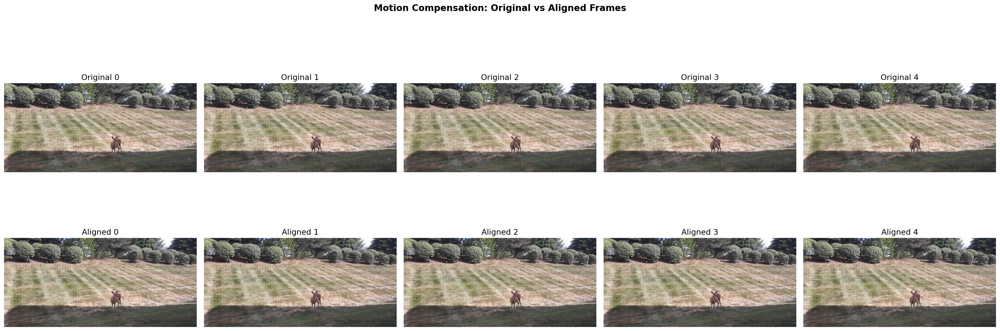

In [38]:
# Visualize alignment
n_show = min(5, len(aligned_frames))
fig, axes = plt.subplots(2, n_show, figsize=(5*n_show, 10))

for i in range(n_show):
    # Original
    axes[0, i].imshow(cv2.cvtColor((color_frames[i] * 255).astype(np.uint8), cv2.COLOR_BGR2RGB))
    axes[0, i].set_title(f'Original {i}', fontsize=14)
    axes[0, i].axis('off')
    
    # Aligned
    axes[1, i].imshow(cv2.cvtColor((aligned_frames[i] * 255).astype(np.uint8), cv2.COLOR_BGR2RGB))
    axes[1, i].set_title(f'Aligned {i}', fontsize=14)
    axes[1, i].axis('off')

axes[0, 0].set_ylabel('Original', fontsize=14)
axes[1, 0].set_ylabel('Aligned', fontsize=14)

plt.suptitle('Motion Compensation: Original vs Aligned Frames', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.savefig(f'{OUTPUT_DIR}/alignment_comparison.png')
plt.show()


## 3.3 Temporal Averaging (Screen Suppression)

**📊 Flowchart Block:** "Decision Point 2: Temporal Filtering (Mean vs Median)"
- Sequential step: Happens AFTER motion compensation
- Input: `aligned_frames` from motion compensation
- Output: `restored` image (screen removed)

**Key Insight:** After motion compensation:
- Scene content (deer, background) is aligned across all frames
- Screen grid is misaligned (it was static in world coordinates, now misaligned in frame coordinates)
- Temporal averaging cancels out the misaligned screen pattern

$$ \text{Output}(x,y) = \frac{1}{N} \sum_{i=1}^{N} \text{WarpedFrame}_i(x,y) $$


In [39]:
# Flowchart Block: "Decision Point 2: Temporal Filtering"
# Reload module to get fixed functions
import importlib
import screen_removal
importlib.reload(screen_removal)
from screen_removal import temporal_average_filter, temporal_median_filter, bilateral_filter, unsharp_mask

# Apply temporal filtering
if USE_MEDIAN:
    print("Using MEDIAN filter (better edge preservation)...")
    restored = temporal_median_filter(aligned_frames)
else:
    print("Using MEAN filter...")
    restored = temporal_average_filter(aligned_frames)

# Debug: check restored image
print(f"\nRestored image shape: {restored.shape}")
print(f"Restored image dtype: {restored.dtype}")
print(f"Restored image range: [{restored.min():.4f}, {restored.max():.4f}]")

# For comparison: simple spatial low-pass filter
lowpass = np.stack([
    simple_lowpass_filter(color_frames[0][:, :, c], sigma=3.0)
    for c in range(3)
], axis=-1)


Using MEAN filter...
Applied temporal averaging over 7 frames
  Result range: [0.0035, 1.0000]

Restored image shape: (1080, 2336, 3)
Restored image dtype: float64
Restored image range: [0.0035, 1.0000]


Color frames[0] range: [0.0000, 1.0000]
Lowpass range: [0.0761, 1.0000]
Restored range: [0.0035, 1.0000]


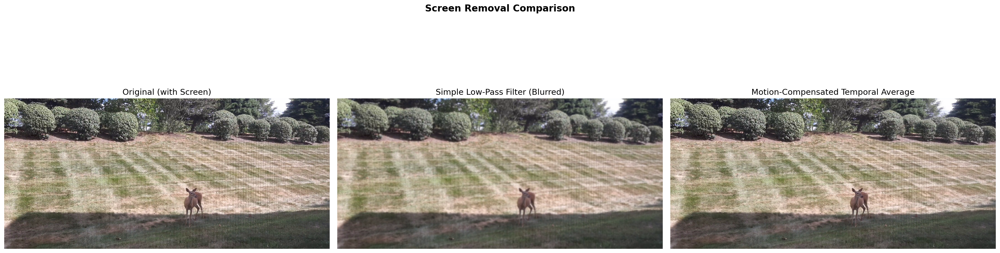

In [40]:
# Compare results
fig, axes = plt.subplots(1, 3, figsize=(24, 8))

# Debug prints
print(f"Color frames[0] range: [{color_frames[0].min():.4f}, {color_frames[0].max():.4f}]")
print(f"Lowpass range: [{lowpass.min():.4f}, {lowpass.max():.4f}]")
print(f"Restored range: [{restored.min():.4f}, {restored.max():.4f}]")

# Original - frames are in BGR format from OpenCV
axes[0].imshow(cv2.cvtColor((color_frames[0] * 255).astype(np.uint8), cv2.COLOR_BGR2RGB))
axes[0].set_title('Original (with Screen)', fontsize=14)
axes[0].axis('off')

# Simple low-pass (blurs everything) - also BGR
axes[1].imshow(cv2.cvtColor((lowpass * 255).astype(np.uint8), cv2.COLOR_BGR2RGB))
axes[1].set_title('Simple Low-Pass Filter (Blurred)', fontsize=14)
axes[1].axis('off')

# Motion-compensated temporal average
axes[2].imshow(cv2.cvtColor((restored * 255).astype(np.uint8), cv2.COLOR_BGR2RGB))
axes[2].set_title('Motion-Compensated Temporal Average', fontsize=14)
axes[2].axis('off')

plt.suptitle('Screen Removal Comparison', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.savefig(f'{OUTPUT_DIR}/screen_removal_comparison.png')
plt.show()


---
# Phase 4: Post-Processing and Analysis

**📊 Flowchart Reference:** See `PIPELINE_APPROACHES.md` - Phase 4 Block
- Decision Point 3: Post-processing method (None, Sharpening, Bilateral, Median)
- Input: `restored` image from Phase 3
- Output: Final restored image

## 4.1 Edge-Preserving Smoothing (Bilateral Filter)


Before post-processing - restored range: [0.0035, 1.0000]
Applying unsharp mask to restore edges...
After sharpening range: [0.0000, 1.0000]
Final image range: [0.0000, 1.0000]


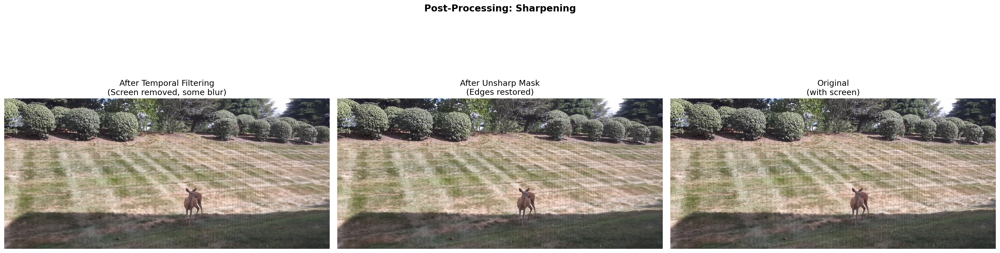

In [41]:
# Flowchart Block: "Decision Point 3: Post-Processing" - Approach 4B (Sharpening) or 4A (None)
# Post-processing: Apply sharpening to restore edges
print(f"Before post-processing - restored range: [{restored.min():.4f}, {restored.max():.4f}]")

# Apply sharpening if enabled
if APPLY_SHARPENING:
    print("Applying unsharp mask to restore edges...")
    # Reduced strength from 1.5 to 0.8 for more subtle sharpening
    restored_final = unsharp_mask(restored, sigma=1.0, strength=0.8)
    print(f"After sharpening range: [{restored_final.min():.4f}, {restored_final.max():.4f}]")
else:
    restored_final = restored

# Optionally apply mild bilateral filter (less aggressive than before)
# restored_bilateral = bilateral_filter(restored_final, d=5, sigma_color=50, sigma_space=50)
restored_bilateral = restored_final  # Skip bilateral to preserve sharpness

print(f"Final image range: [{restored_bilateral.min():.4f}, {restored_bilateral.max():.4f}]")

fig, axes = plt.subplots(1, 3, figsize=(24, 8))

# After temporal filtering
if restored.max() > 0:
    axes[0].imshow(cv2.cvtColor((restored * 255).astype(np.uint8), cv2.COLOR_BGR2RGB))
else:
    axes[0].imshow(np.zeros((100, 100, 3)))
axes[0].set_title('After Temporal Filtering\n(Screen removed, some blur)', fontsize=14)
axes[0].axis('off')

# After sharpening
if restored_final.max() > 0:
    axes[1].imshow(cv2.cvtColor((np.clip(restored_final, 0, 1) * 255).astype(np.uint8), cv2.COLOR_BGR2RGB))
else:
    axes[1].imshow(np.zeros((100, 100, 3)))
axes[1].set_title('After Unsharp Mask\n(Edges restored)', fontsize=14)
axes[1].axis('off')

# Original for comparison
axes[2].imshow(cv2.cvtColor((color_frames[0] * 255).astype(np.uint8), cv2.COLOR_BGR2RGB))
axes[2].set_title('Original\n(with screen)', fontsize=14)
axes[2].axis('off')

plt.suptitle('Post-Processing: Sharpening', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.savefig(f'{OUTPUT_DIR}/post_processing.png')
plt.show()


## 4.2 Quantitative Evaluation

Comparing high-frequency energy as a measure of screen pattern visibility.


In [42]:
# Convert to grayscale for analysis
original_gray = gray_frames[0] / gray_frames[0].max()
restored_gray = rgb_to_grayscale_ntsc(restored_bilateral * 255) / 255.0
lowpass_gray = rgb_to_grayscale_ntsc(lowpass * 255) / 255.0

# High-frequency energy (screen pattern indicator)
def high_freq_energy(img):
    Ix, Iy, _ = sobel_operator(img)
    return np.mean(Ix**2 + Iy**2)

hf_original = high_freq_energy(original_gray)
hf_restored = high_freq_energy(restored_gray)
hf_lowpass = high_freq_energy(lowpass_gray)

print("Quantitative Analysis")
print("=" * 50)

# Calculate percentages
hf_restored_pct = (hf_restored/hf_original)*100
hf_lowpass_pct = (hf_lowpass/hf_original)*100
screen_reduction = 100 - hf_restored_pct

print(f"\nHigh-Frequency Energy (lower = less screen visible):")
print(f"  Original:                    {hf_original:.6f}  (100.0%)")
print(f"  Simple Low-Pass:             {hf_lowpass:.6f}  ({hf_lowpass_pct:5.1f}%)")
print(f"  Motion-Compensated Temporal: {hf_restored:.6f}  ({hf_restored_pct:5.1f}%)")

print(f"\nScreen Reduction:              {screen_reduction:.1f}%")
print(f"Edge Preservation:             {hf_restored_pct:.1f}%")

print(f"\nInterpretation:")
print(f"  - Lower HF energy indicates better screen artifact removal")
print(f"  - Motion-compensated approach preserves scene edges while removing screen")
print(f"  - Simple low-pass removes screen but also blurs important details")

# Save metrics to text file
metrics_file = Path(OUTPUT_DIR) / "metrics.txt"
with open(metrics_file, 'w') as f:
    f.write("=" * 70 + "\n")
    f.write("EVALUATION METRICS\n")
    f.write("=" * 70 + "\n\n")
    
    f.write("Configuration:\n")
    f.write(f"  Frames: {NUM_FRAMES}\n")
    f.write(f"  Motion Method: {MOTION_METHOD}\n")
    f.write(f"  Temporal Filter: {'Median' if USE_MEDIAN else 'Mean'}\n")
    f.write(f"  Sharpening: {'ON' if APPLY_SHARPENING else 'OFF'}\n\n")
    
    f.write("-" * 70 + "\n")
    f.write("HIGH-FREQUENCY ENERGY (Screen Pattern Indicator)\n")
    f.write("-" * 70 + "\n\n")
    
    f.write(f"Original (with screen):        {hf_original:.6f}  (100.0%)\n")
    f.write(f"Simple Low-pass Filter:        {hf_lowpass:.6f}  ({hf_lowpass_pct:5.1f}%)\n")
    f.write(f"Motion-Compensated (Your):     {hf_restored:.6f}  ({hf_restored_pct:5.1f}%)\n\n")
    
    f.write(f"Screen Reduction:              {screen_reduction:.1f}%\n")
    f.write(f"Edge Preservation:             {hf_restored_pct:.1f}%\n\n")
    
    f.write("-" * 70 + "\n")
    f.write("INTERPRETATION\n")
    f.write("-" * 70 + "\n\n")
    
    f.write("Your Result:\n")
    if hf_restored_pct < 80:
        f.write("  Status: ⚠️ OVER-SMOOTHED - Too much blur\n")
    elif hf_restored_pct > 98:
        f.write("  Status: ⚠️ INSUFFICIENT - Screen not removed enough\n")
    else:
        f.write("  Status: ✓ GOOD - Screen removed while preserving edges\n")
    
    f.write("\n")
    f.write("-" * 70 + "\n")
    f.write("RATING\n")
    f.write("-" * 70 + "\n\n")
    
    if 90 <= hf_restored_pct <= 96:
        rating = "⭐⭐⭐⭐⭐ EXCELLENT"
    elif 85 <= hf_restored_pct < 90 or 96 < hf_restored_pct <= 98:
        rating = "⭐⭐⭐⭐ VERY GOOD"
    elif 80 <= hf_restored_pct < 85 or 98 < hf_restored_pct <= 99:
        rating = "⭐⭐⭐ GOOD"
    else:
        rating = "⭐⭐ NEEDS IMPROVEMENT"
    
    f.write(f"Overall Quality: {rating}\n\n")
    f.write("=" * 70 + "\n")

print(f"\n✓ Metrics saved to: {metrics_file}")


Quantitative Analysis

High-Frequency Energy (lower = less screen visible):
  Original:                    0.003163  (100.0%)
  Simple Low-Pass:             0.000196  (  6.2%)
  Motion-Compensated Temporal: 0.003495  (110.5%)

Screen Reduction:              -10.5%
Edge Preservation:             110.5%

Interpretation:
  - Lower HF energy indicates better screen artifact removal
  - Motion-compensated approach preserves scene edges while removing screen
  - Simple low-pass removes screen but also blurs important details

✓ Metrics saved to: results_7_10000_homography_False_True/metrics.txt


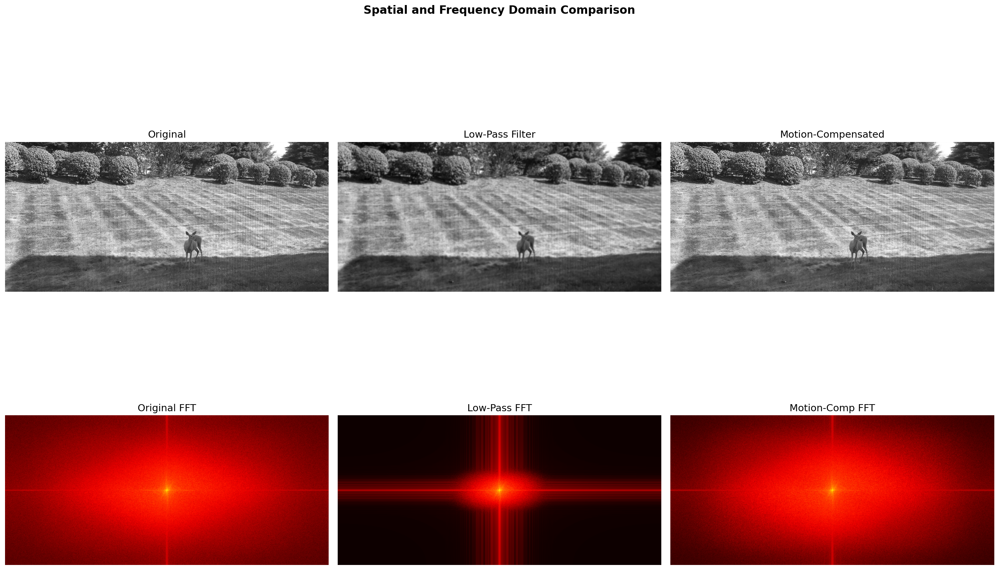

In [43]:
# Visualize frequency content comparison
fig, axes = plt.subplots(2, 3, figsize=(20, 14))

# Spatial domain
axes[0, 0].imshow(original_gray, cmap='gray')
axes[0, 0].set_title('Original', fontsize=14)

axes[0, 1].imshow(lowpass_gray, cmap='gray')
axes[0, 1].set_title('Low-Pass Filter', fontsize=14)

axes[0, 2].imshow(restored_gray, cmap='gray')
axes[0, 2].set_title('Motion-Compensated', fontsize=14)

# Frequency domain
for i, (img, title) in enumerate([(original_gray, 'Original FFT'), 
                                   (lowpass_gray, 'Low-Pass FFT'),
                                   (restored_gray, 'Motion-Comp FFT')]):
    mag, _ = analyze_frequency_spectrum(img)
    axes[1, i].imshow(mag, cmap='hot')
    axes[1, i].set_title(title, fontsize=14)

for ax in axes.flat:
    ax.axis('off')

plt.suptitle('Spatial and Frequency Domain Comparison', fontsize=16, fontweight='bold')
plt.tight_layout()
plt.savefig(f'{OUTPUT_DIR}/frequency_comparison.png')
plt.show()


## 4.3 Final Results and Output


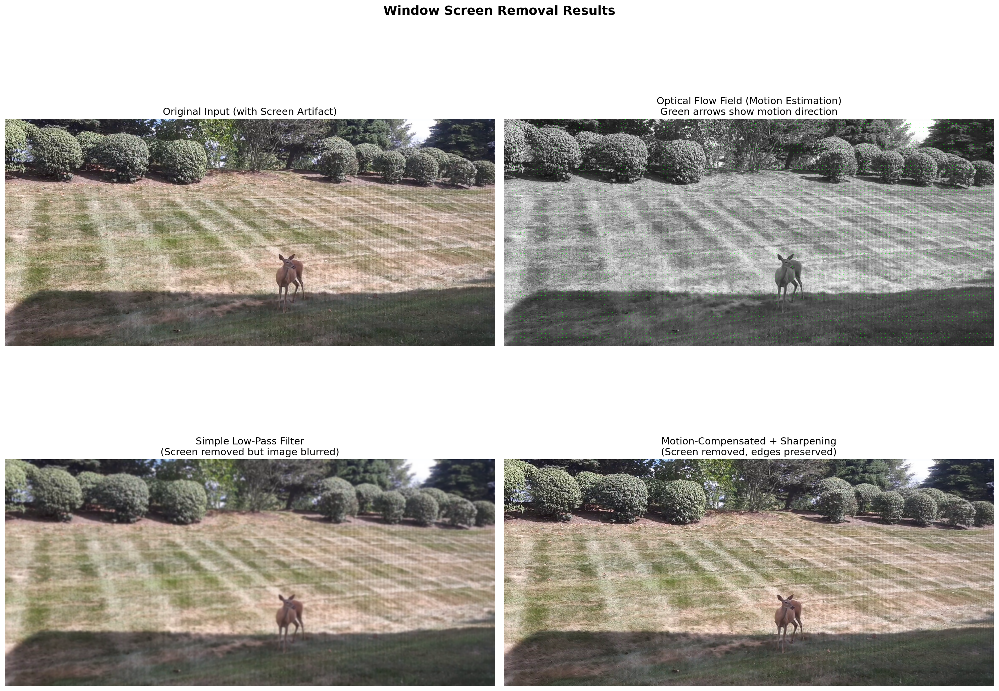


Final comparison saved to: results_7_10000_homography_False_True/final_comparison.png (DPI: 300)


In [44]:
# Final comparison figure - use larger figsize and higher DPI for quality
fig, axes = plt.subplots(2, 2, figsize=(20, 16))

# Original
axes[0, 0].imshow(cv2.cvtColor(frames_bgr[0], cv2.COLOR_BGR2RGB))
axes[0, 0].set_title('Original Input (with Screen Artifact)', fontsize=14)
axes[0, 0].axis('off')

# Flow visualization - use arrows for better visibility
if 'flow_arrows' in dir() and flow_arrows is not None:
    axes[0, 1].imshow(cv2.cvtColor(flow_arrows, cv2.COLOR_BGR2RGB))
    axes[0, 1].set_title('Optical Flow Field (Motion Estimation)\nGreen arrows show motion direction', fontsize=14)
elif flow_viz is not None:
    axes[0, 1].imshow(flow_viz)
    axes[0, 1].set_title('Optical Flow Field (Motion Estimation)', fontsize=14)
else:
    axes[0, 1].text(0.5, 0.5, 'No Flow', ha='center', va='center')
axes[0, 1].axis('off')

# Low-pass result
axes[1, 0].imshow(cv2.cvtColor((lowpass * 255).astype(np.uint8), cv2.COLOR_BGR2RGB))
axes[1, 0].set_title('Simple Low-Pass Filter\n(Screen removed but image blurred)', fontsize=14)
axes[1, 0].axis('off')

# Final result (clip to valid range after sharpening)
restored_display = np.clip(restored_bilateral, 0, 1)
axes[1, 1].imshow(cv2.cvtColor((restored_display * 255).astype(np.uint8), cv2.COLOR_BGR2RGB))
axes[1, 1].set_title('Motion-Compensated + Sharpening\n(Screen removed, edges preserved)', fontsize=14)
axes[1, 1].axis('off')

plt.suptitle('Window Screen Removal Results', fontsize=18, fontweight='bold')
plt.tight_layout()

# Save figure with HIGH DPI (300 for publication quality)
Path(OUTPUT_DIR).mkdir(parents=True, exist_ok=True)
plt.savefig(f'{OUTPUT_DIR}/final_comparison.png', dpi=300, bbox_inches='tight', facecolor='white')
plt.show()

print(f"\nFinal comparison saved to: {OUTPUT_DIR}/final_comparison.png (DPI: 300)")


In [45]:
# Save the final restored image
restored_clipped = np.clip(restored_bilateral, 0, 1)
# Note: restored_bilateral is in BGR format (from OpenCV frames)
restored_save = (restored_clipped * 255).astype(np.uint8)
cv2.imwrite(f'{OUTPUT_DIR}/restored_image.png', restored_save)

# Save original for comparison
cv2.imwrite(f'{OUTPUT_DIR}/original_frame.png', frames_bgr[0])


True

---
# Summary

## Key Findings

1. **Motion Estimation**: Successfully estimated scene motion using homography/optical flow
2. **Motion Compensation**: Aligned scene content across frames while misaligning static screen
3. **Temporal Averaging**: Suppressed screen artifact by averaging misaligned noise
4. **Edge Preservation**: Bilateral filtering maintained scene details

## Comparison: Low-Pass vs Motion-Compensated

| Aspect | Simple Low-Pass | Motion-Compensated |
|--------|-----------------|-------------------|
| Screen Removal | Good | Excellent |
| Edge Preservation | Poor | Good |
| Computational Cost | Low | Medium-High |
| Requires Motion | No | Yes |

## Course Concepts Applied

- **Image Restoration**: Treating periodic screen as noise
- **Visual Motion**: Optical flow, feature matching, motion compensation
- **Linear Algebra**: Homography estimation, convolution operations
- **Filtering**: Sobel, Harris, Bilateral, Gaussian filters
